In [2]:
# NOTE FOR LOCAL EXECUTION: use pytorch kernel and execute the code below to specify cuda device
import os
os.environ["CUDA_VISIBLE_DEVICES"]="0"

# BERT and Explainable AI

## Load required libraries

In [3]:
!pip install pandas
!pip install transformers
!pip install transformers-interpret

## Import libraries

In [1]:
from utils import *
import pandas as pd
import pickle
from transformers import AutoModelForSequenceClassification, AutoTokenizer
from transformers_interpret import SequenceClassificationExplainer

c:\Users\david\OneDrive - Universitat de Barcelona\GitHub\New explainability implementation\big_five\CONS\utils.py:10: FutureWarning: load_metric is deprecated and will be removed in the next major version of datasets. Use 'evaluate.load' instead, from the new library 🤗 Evaluate: https://huggingface.co/docs/evaluate
  auc_metric = load_metric("roc_auc", trust_remote_code=True)


## Load data

In [2]:
# Original data
#df = pd.read_csv(r"C:\Users\david\OneDrive - Universitat de Barcelona (1)\Documentos\GitHub\Explainability\essays.csv", encoding = "latin-1")

# Alternatively, load fragmented validation and test partitions
df_train = pd.read_csv(r"C:\Users\david\OneDrive - Universitat de Barcelona\GitHub\New explainability implementation\datasets\df_essays_fragm_train.csv")
df_valid = pd.read_csv(r"C:\Users\david\OneDrive - Universitat de Barcelona\GitHub\New explainability implementation\datasets\df_essays_fragm_valid.csv")
df_test = pd.read_csv(r"C:\Users\david\OneDrive - Universitat de Barcelona\GitHub\New explainability implementation\datasets\df_essays_fragm_test.csv")
#df = pd.concat([df_valid, df_test], axis=0, ignore_index=True)
df = df_test

# Another alternative, load training partition
#df = df_train

df.head()

,#AUTHID,TEXT,cEXT,cNEU,cAGR,cCON,cOPN
0,2000_999176.txt,spark up a conversation with a member of the o...,0,1,0,0,1
1,1999_915632.txt,well I just got back from my home town in hunt...,0,0,0,1,0
2,2000_515950.txt,"that I would not be like the rest, but an indi...",0,1,0,0,1
3,2000_935195.txt,So here are twenty minutes of Brian's thoughts...,0,0,0,1,1
4,2000_933158.txt,know it they'll be a big nobody in the world. ...,1,1,1,1,1


In [6]:
print(len(df))

703


## Define Trait

In [3]:
trait = "cCON"

## Load the fine-tuned model

In [4]:
# Path to the fine-tuned model
#model_path = r"C:\Users\david\OneDrive - Universitat de Barcelona (1)\Documentos\GitHub\Explainability\Agreeableness\results_agreeableness"  # my laptop
model_path = r"C:\Users\david\OneDrive - Universitat de Barcelona\GitHub\New explainability implementation\fine_tuning_models\results_conscientiousness_fragm"

# Load the fine-tuned model and tokenizer
model_name = "bert-base-uncased"
tokenizer = AutoTokenizer.from_pretrained(model_name, do_lower_case=True)
fine_tuned_model = AutoModelForSequenceClassification.from_pretrained(model_path)
cls_explainer = SequenceClassificationExplainer(fine_tuned_model, tokenizer)
print(cls_explainer.device)

cpu


  0%|          | 0/88 [00:00<?, ?it/s]

Trainer is attempting to log a value of "[[182 147]
 [133 241]]" of type <class 'numpy.ndarray'> for key "eval/conf_matrix" as a scalar. This invocation of Tensorboard's writer.add_scalar() is incorrect so we dropped this attribute.


{'eval_loss': 0.8709123134613037, 'eval_accuracy': 0.6017069701280228, 'eval_roc_auc': 0.5987882580498352, 'eval_conf_matrix': array([[182, 147],
       [133, 241]], dtype=int64), 'eval_runtime': 356.9114, 'eval_samples_per_second': 1.97, 'eval_steps_per_second': 0.247}


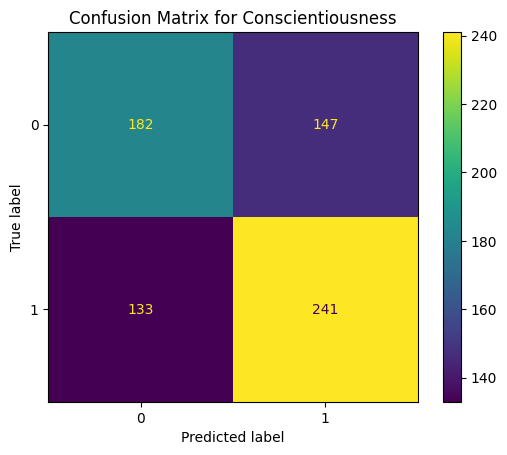

In [5]:
# Check that the model is correct

# Create datasets
X_train, X_valid, y_train, y_valid = create_partition_from_split(df_train, df_valid, 'TEXT', trait)
_, X_test, _, y_test = create_partition_from_split(df_train, df_test, 'TEXT', trait)
train_dataset, valid_dataset = create_datasets(tokenizer, X_train, X_valid, y_train, y_valid)
_, test_dataset = create_datasets(tokenizer, X_train, X_test, y_train, y_test)

# Create trainer
trainer = Trainer(
        model=fine_tuned_model,          # the instantiated Transformers model to be trained
        args=None,                       # training arguments
        train_dataset=train_dataset,     # training dataset
        eval_dataset=test_dataset,      # evaluation dataset
        compute_metrics=compute_metrics, # the callback that computes metrics of interest
        #optimizers=(optimizer, None)
    )

results = trainer.evaluate()
conf_matrix = results['eval_conf_matrix']
print(results)
disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix)
disp.plot()

# Add a title to the confusion matrix plot
plt.title("Confusion Matrix for Conscientiousness")
plt.show()

In [11]:
import pickle

# Set the desired maximum sequence length
max_sequence_length = 512
attribution_threshold = 0.5  # Adjust the threshold as needed

# List to store word attributions for each row
all_word_attributions = []

# List to store sum of attributions for each row
all_sum_attributions = []

# Loop through all rows in the dataset
print("Number of rows:", len(df))
for row_index in range(len(df)):
    # Show progress every 100 sentences
    if row_index%100 == 0:
        print(row_index)

    preproc_text = get_preproc_text(df, row_index, tokenizer, max_sequence_length)
    word_attributions = cls_explainer(preproc_text)
    true_class = df.loc[row_index, trait]
    predicted_class = cls_explainer.predicted_class_name

    # Print the terms with scores greater than the threshold
    for token, score in word_attributions:
        if abs(score) > attribution_threshold:
            print(f'Token: {token}, Score: {score}')

    # Save the filtered attributions for this row along with true_class and predicted_class
    attribution_info = (word_attributions, true_class, predicted_class)
    all_word_attributions.append(attribution_info)

    # Visualize if there are filtered attributions
    if any(abs(score) > attribution_threshold for _, score in word_attributions):
        cls_explainer.visualize(true_class=true_class)
    
    # Sum of attributions for the entire text
    sum_attribution = cls_explainer.attributions.attributions_sum.sum()

    # Save the sum of attributions for this row
    all_sum_attributions.append((sum_attribution.item(), true_class, predicted_class))
        
# Save all_word_attributions to a file
word_attr_fname = get_all_word_attr_fname_essays(trait)
with open(word_attr_fname, 'wb') as file:
    pickle.dump(all_word_attributions, file)

# Save all_sum_attributions to a file
sum_attr_fname = get_all_sum_attr_fname_essays(trait)
with open(sum_attr_fname, 'wb') as file:
    pickle.dump(all_sum_attributions, file)

Number of rows: 703
0
Token: och, Score: -0.73251103918188


Token: absolute, Score: -0.7349816654986852


Token: cheryl, Score: 0.5599194683254358


Token: nicole, Score: -0.582149594835756


Token: carol, Score: 0.6593162657857811


Token: polo, Score: 0.7645206629776627


Token: sammy, Score: 0.6346600290866755


Token: peace, Score: -0.7049550580723992


Token: okay, Score: 0.6997631747063003


Token: girls, Score: 0.7427409868668806


Token: minute, Score: -0.6194614020936314


Token: somebody, Score: -0.6973519361972222


Token: tune, Score: 0.6130119965248387


Token: subway, Score: 0.6165411147406792


Token: write, Score: -0.5515408608726852


Token: ., Score: 0.6317209422774249


Token: austin, Score: 0.6731422428461193


Token: traffic, Score: -0.5177184888099856


Token: ut, Score: 0.693245435811301
Token: thy, Score: 0.5206049789707659


Token: ut, Score: 0.5519562527544581


Token: ##nier, Score: 0.598266230055826


Token: psychology, Score: -0.5844164810829117
Token: everyday, Score: -0.5733900682384363


Token: sometime, Score: -0.6057620921306107


Token: chill, Score: -0.511548371327372
Token: murphy, Score: 0.5113291872621767


Token: things, Score: 0.5080897813403163


Token: drag, Score: 0.5203114886648607


Token: screwed, Score: -0.6997873492159138


Token: unit, Score: 0.5045666523244636


Token: aim, Score: 0.5290454894455957


Token: dad, Score: -0.5732883981358318


Token: talking, Score: -0.5429031046831136


Token: confusion, Score: -0.85699974316411


Token: economy, Score: 0.6729695200583888


Token: money, Score: 0.7280430386801594


Token: chinese, Score: -0.6528815628137582


Token: villas, Score: 0.6583815966060019


Token: psychology, Score: 0.7077825693898643


Token: tapes, Score: -0.5260136051649698


Token: trance, Score: -0.6878312977975716


Token: scuba, Score: 0.7437887036231813


Token: women, Score: -0.5479199342454941


Token: phone, Score: 0.6648236699117708


Token: ka, Score: 0.7096767276331771


Token: chicken, Score: -0.8723868461843879


Token: cultural, Score: -0.6505206472783537
Token: anthropology, Score: 0.6763164199989116


Token: pizza, Score: 0.6949572423647397


Token: communications, Score: 0.8986671715871589


100
Token: jeff, Score: 0.6740646655273748


Token: happiness, Score: -0.8065312566082078


Token: psychology, Score: -0.5670550989893978


Token: tier, Score: -0.5186608481571897


Token: ut, Score: 0.5618504154279257


Token: thing, Score: 0.6590412494143274


Token: drugs, Score: -0.5446433266716696


Token: ##ntly, Score: -0.5355579346020485


Token: instant, Score: -0.5178032591178325


Token: in, Score: 0.5187737811712407


Token: translations, Score: -0.6918150054902222


Token: holiday, Score: 0.7467681945863389


Token: yesterday, Score: 0.5141809141315704


Token: awe, Score: 0.6190898065673637
Token: holden, Score: -0.5995608032441192


Token: sar, Score: 0.575563846653006


Token: blackness, Score: 0.6626188005732602


Token: austin, Score: -0.6619551975467034
Token: lp, Score: 0.5435802907115553


Token: austin, Score: -0.5821616593775504


Token: texas, Score: -0.5291015945279831


Token: bands, Score: 0.5455206830400504
Token: orlando, Score: -0.6414270209653583


Token: everyone, Score: -0.5576994245177572


Token: ##rita, Score: 0.5213194925239457


Token: cash, Score: 0.6537606899721219


Token: tt, Score: 0.5415292652337724


Token: boyfriend, Score: -0.5078897391079723


Token: cold, Score: 0.585994925759526


Token: cancel, Score: 0.5926958205141278


Token: phase, Score: -0.6878336707781414


Token: cristina, Score: -0.5985478815141808


Token: organization, Score: 0.5591456033976804


Token: cafe, Score: -0.8419400279126869


Token: spit, Score: 0.7368768467424768


Token: psycho, Score: -0.5326376881070636


Token: blonde, Score: 0.7266159731180978


Token: dirty, Score: 0.5601516475835565


Token: nursing, Score: 0.6064586603125709


Token: governor, Score: 0.6525545514325133


Token: maintenance, Score: 0.9341920530473947


Token: bill, Score: 0.6874878036842028


Token: rhetoric, Score: -0.603832034776552
Token: geology, Score: -0.5555837849277188


Token: president, Score: 0.7761584072771255


Token: tom, Score: -0.6644394744235959


Token: time, Score: 0.6105851220191109


Token: variety, Score: -0.6203267686162955


Token: ##ctic, Score: -0.5138696806555386


Token: vomiting, Score: -0.7375071836711471


Token: ginger, Score: 0.8295269561812311


Token: space, Score: 0.5650025845855567


Token: grapes, Score: -0.5094822088872202


Token: ut, Score: -0.7201832047547279


200
Token: architectural, Score: 0.5259613300292365


Token: kristen, Score: -0.5465820173300218


Token: moments, Score: 0.5706442121043633


Token: jealous, Score: -0.6160935325797656


Token: to, Score: 0.5289748483719436


Token: ill, Score: -0.7724653939823247


Token: tissue, Score: 0.8542987189436434


Token: minutes, Score: 0.59119136715576
Token: san, Score: 0.5020960345326276


Token: direction, Score: 0.7216572713067807


Token: glimpse, Score: 0.5123009083544378


Token: also, Score: -0.5068513087866501


Token: a, Score: 0.7350756337533187


Token: /, Score: -0.5086963888481996


Token: acid, Score: 0.7158396466799796


Token: austin, Score: -0.6610353889704143


Token: teams, Score: 0.7083092601488684


Token: photography, Score: -0.6595282697270604


Token: content, Score: 0.6272943132959099


Token: yesterday, Score: -0.6515778886594077


Token: today, Score: 0.5154801366440257


Token: shape, Score: -0.5922411018753522


Token: college, Score: 0.7804731775884299


Token: relaxing, Score: 0.5680639003853001


Token: pont, Score: -0.5241144390196523


Token: asian, Score: 0.5870803921502726


Token: texas, Score: -0.5491901191551007


Token: virgin, Score: -0.6312490049569989


Token: subway, Score: 0.7256542955261702


Token: tracy, Score: 0.652215554367913


Token: ##ytic, Score: 0.5111943078015476


Token: homework, Score: 0.7943204839323278


Token: criminal, Score: -0.6085292470294799


Token: reads, Score: 0.7897368407868336


Token: volleyball, Score: 0.5945396188433505


Token: wasting, Score: -0.5075001502945624


Token: relativity, Score: 0.739852431210747


Token: orange, Score: 0.5057613723793748
Token: orange, Score: 0.5177824546244031


Token: guy, Score: 0.5414686413327727


Token: winter, Score: -0.5827591383599888


Token: bitterness, Score: 0.7186494518530328


Token: classes, Score: 0.6886244072714347


300
Token: georgie, Score: -0.7062986697462473


Token: cigarette, Score: -0.5739666071175424


Token: the, Score: -0.6068434118006488


Token: english, Score: 0.7141140538740226


Token: dinner, Score: 0.532144735153796


Token: dioxide, Score: 0.608085975571123


Token: ##phi, Score: -0.5146282559812825


Token: stacy, Score: 0.8029643262976013


Token: laundry, Score: 0.7960319612372162


Token: gore, Score: 0.5306631178174946


Token: dallas, Score: -0.5059410083289225


Token: mimi, Score: 0.7527108827465709


Token: rowing, Score: 0.6599463929609083


Token: gifts, Score: -0.7683720223266589


Token: statement, Score: -0.6356620158674149


Token: thug, Score: -0.7180796178964197


Token: bliss, Score: 0.6177629100589015


Token: christine, Score: 0.692569645454368


Token: theatre, Score: 0.500779570640919


Token: flirt, Score: 0.6430017873771359


Token: brazil, Score: 0.5436102518883849


Token: austin, Score: -0.661578331804441


Token: guadalupe, Score: -0.6224483307674651


Token: olivia, Score: 0.5149437502572654


Token: minutes, Score: 0.528815685836983


Token: consciousness, Score: 0.5095954217288121


Token: bye, Score: 0.7379093480766935


Token: hers, Score: -0.7739362638956818


Token: dream, Score: -0.575526413157027


Token: ours, Score: 0.9677693766748431


Token: scared, Score: 0.6776041290084777


Token: climbing, Score: -0.5042315861957027


Token: familiarity, Score: -0.8758071078547635


Token: julie, Score: 0.9404105400010799


Token: sorry, Score: -0.5546077674662236


Token: phase, Score: 0.5313705695666614


Token: !, Score: 0.5544267888100622


Token: ##re, Score: 0.5807987871477012


Token: raises, Score: 0.514342132548023


Token: friendship, Score: 0.580074227286006


Token: jennifer, Score: 0.7727394047213227


Token: nap, Score: 0.9238800958106766


Token: ##bing, Score: -0.5868539341680172


Token: nick, Score: -0.8013392453620062


400
Token: utopia, Score: 0.6717151866307892


Token: ut, Score: 0.7435259742677819


Token: friendship, Score: -0.7096255099237065


Token: spiders, Score: 0.9050863243936559


Token: work, Score: 0.7943179407123461


Token: pharmacy, Score: 0.9148035697792092


Token: girl, Score: 0.5293991097405059


Token: captive, Score: 0.7643552180322098


Token: pa, Score: -0.6044829713183303


Token: ticket, Score: 0.580415473454915


Token: bit, Score: 0.5863385713882694


Token: media, Score: -0.5024250005301213


Token: laptop, Score: 0.6101330857421463


Token: uss, Score: 0.6290954526579394


Token: pictures, Score: 0.5044759120194601
Token: assignment, Score: 0.5736322908868254


Token: emmy, Score: 0.5020714232213792


Token: wandering, Score: 0.6468375927436723


Token: movies, Score: 0.5201111782919378
Token: times, Score: -0.5343126370221268


Token: immigrants, Score: 0.7539314156014445


Token: ye, Score: 0.7357089707013955


Token: soccer, Score: 0.5076702192053276
Token: fall, Score: 0.5139146372687364


Token: embarrassment, Score: -0.692400702319737


Token: corresponding, Score: -0.6349414929456708


Token: lexie, Score: 0.6241626324983373


Token: cheerleading, Score: 0.6138269042114014


Token: diving, Score: 0.8478351794489487


Token: before, Score: -0.6955190200489662


Token: solve, Score: -0.7440581838455294


Token: rue, Score: -0.5609286406859046


Token: cool, Score: 0.5166068552936106


Token: kids, Score: 0.5105069861133966


Token: shopping, Score: 0.514401667106841


Token: directions, Score: -0.6264826190608235


Token: for, Score: -0.6033399036896272
Token: want, Score: 0.5054068569525457


Token: marriage, Score: 0.75537647709794


Token: money, Score: 0.6880554577671146


Token: enrique, Score: 0.8199931961499229


Token: spirits, Score: 0.7301704272712596


Token: murphy, Score: 0.6474762703323702


Token: aug, Score: -0.6362767557841162


Token: shall, Score: 0.5566622959330028
Token: submit, Score: 0.695152919122177


500
Token: assignments, Score: -0.7424355529735686


Token: games, Score: -0.6318491116630465


Token: college, Score: 0.7379116736498524


Token: relaxation, Score: -0.5917088587724393


Token: grease, Score: -0.7353339612252449


Token: nature, Score: -0.7905420948778631


Token: mist, Score: -0.6042480509939556


Token: studying, Score: -0.6948400487156519


Token: surfing, Score: 0.5486513267311606


Token: skinny, Score: 0.830693449978515


Token: old, Score: -0.5826454610679683


Token: logic, Score: -0.5751547403011743


Token: soul, Score: -0.6703464526931169


Token: semester, Score: 0.5384380025689464


Token: alias, Score: 0.520817782162842
Token: monopoly, Score: 0.5513928550714285


Token: texas, Score: 0.6680991980256776


Token: freedom, Score: -0.577198051678692


Token: stuff, Score: -0.5189085441966422


Token: shall, Score: -0.5031648729441583


Token: ending, Score: -0.5724846879744951


Token: seville, Score: 0.6755932602699395


Token: baseball, Score: 0.5167329612335511


Token: sigh, Score: 0.5479278762841874


Token: soo, Score: -0.6608052585079291


Token: projects, Score: -0.5736255328847438


Token: paint, Score: -0.6099624448929504


Token: pan, Score: 0.5715119412107088


Token: writing, Score: -0.5610788066726136


Token: concert, Score: 0.5434681891779348


Token: fred, Score: 0.5247132937493062


Token: session, Score: 0.5552725671564596


Token: situations, Score: -0.575202132568675


Token: sweater, Score: 0.5382664884527245
Token: laura, Score: -0.5731257678044344


Token: sorority, Score: 0.7102003095523531


Token: typing, Score: 0.5029767901268924


Token: minutes, Score: 0.5000051052998516


Token: ticking, Score: 0.5433427997991085


Token: these, Score: 0.5111014826815831


Token: psyche, Score: 0.8413015095194006


600
Token: condoms, Score: -0.7613683492755703


Token: texas, Score: -0.7662842974764896


Token: guys, Score: 0.5965907143612467


Token: charms, Score: -0.7020673011692535


Token: math, Score: 0.5871260469132284
Token: friday, Score: -0.5139181081688096


Token: retreat, Score: -0.5753378786773781


Token: music, Score: 0.6018436995934447


Token: flowers, Score: 0.6412536721016443


Token: sarcasm, Score: 0.5593929445383885


Token: showered, Score: 0.6641276924180696


Token: bullshit, Score: 0.6847767024591037


Token: gum, Score: -0.8156183574683256


Token: gregory, Score: 0.5886251618961631


Token: building, Score: 0.8296924195831398


Token: changing, Score: -0.7500011547468328


Token: the, Score: -0.5852843575536332


Token: daughter, Score: -0.5191842082925975


Token: devil, Score: 0.7697622681960397


Token: mine, Score: -0.5075774483735939


Token: chocolate, Score: -0.6257217293320049


Token: arun, Score: 0.5173078214734177


Token: continuously, Score: -0.7296221189736759


Token: judd, Score: 0.5159691941515026


Token: rock, Score: -0.6100664708991731


Token: tiffany, Score: 0.6051400661527825


Token: psychology, Score: 0.7326706023715865


Token: kurt, Score: -0.8019927661126521


Token: mexican, Score: -0.8103301913553651


Token: ., Score: 0.6544026923676544


Token: dollars, Score: -0.5112226602452888


Token: constantly, Score: 0.5514207735358804


Token: revolutions, Score: -0.7943098766997146


Token: knows, Score: 0.7506741992008646


Token: somewhere, Score: -0.5329959862310578


Token: typing, Score: -0.7993980962072267


Token: writing, Score: -0.6747468312718199


Token: religion, Score: 0.7252658275650311


Token: soccer, Score: -0.523838988586709


Token: typing, Score: -0.7035833330479176


Token: minutes, Score: 0.5008455916535216


Token: addicted, Score: -0.5445388893854612


Token: o, Score: 0.5765628755648355


Token: typing, Score: 0.7879449012537161


Token: songs, Score: -0.6881824823503919


Token: science, Score: -0.6951249968743345


Token: ye, Score: -0.5619586366232182


Token: somebody, Score: -0.6130156875868864


Token: words, Score: -0.6553437557941242


Token: kristen, Score: -0.6719322997465715


Token: couples, Score: 0.7116442133620959


700
Token: ethernet, Score: -0.731999343933919
Token: laptop, Score: 0.5001572174611061


In [5]:
import pickle

word_attr_fname = get_all_word_attr_fname_essays(trait)
sum_attr_fname = get_all_sum_attr_fname_essays(trait)

# Load the previously saved attributions from the file
with open(word_attr_fname, 'rb') as file:
    all_word_attributions = pickle.load(file)

# Load the previously saved attributions from the file
with open(sum_attr_fname, 'rb') as file:
    all_sum_attributions = pickle.load(file)

## Obtain Word Frequencies 

In [6]:
word_freq = get_word_freqs(all_word_attributions)
word_freq_label_1 = get_word_freqs(all_word_attributions, "LABEL_1")
word_freq_label_0 = get_word_freqs(all_word_attributions, "LABEL_0")

## Obtain Positive and Negative Attributions

In [7]:
# Get positive and negative attributions for the two labels
force_correct_classif=True
positive_attributions_label_1 = filter_attributions(all_word_attributions, '+', "LABEL_1", force_correct_classif)
positive_attributions_label_0 = filter_attributions(all_word_attributions, '+', "LABEL_0", force_correct_classif)
negative_attributions_label_1 = filter_attributions(all_word_attributions, '-', "LABEL_1", force_correct_classif)
negative_attributions_label_0 = filter_attributions(all_word_attributions, '-', "LABEL_0", force_correct_classif)

## Word Filtering Functions

In [8]:
# !pip install nltk

import nltk
from nltk.corpus import stopwords

# Obtain stop words
nltk.download('stopwords')
english_stopwords = stopwords.words('english')
#print(english_stopwords)

# Obtain list of words
nltk.download('words')
english_words = set(nltk.corpus.words.words())
#print(len(english_words))

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\david\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package words to
[nltk_data]     C:\Users\david\AppData\Roaming\nltk_data...
[nltk_data]   Package words is already up-to-date!


## Word Clouds
### By attribution score

In [11]:
from wordcloud import WordCloud
from collections import Counter
import matplotlib.pyplot as plt

min_word_freq = 10
min_word_len = 4
sum_techniques = ["freq", "avg", "max", "accum", "gmean"]
#sum_techniques = ["avg"]

for sum_technique in sum_techniques:

    # Create separate lists for positive and negative attributions for LABEL_1
    filtered_words = filter_words(english_words, english_stopwords, word_freq_label_1, positive_attributions_label_1, min_word_freq, min_word_len)
    positive_words_label_1 = summarize_scores(filtered_words, sum_technique)
    filtered_words = filter_words(english_words, english_stopwords, word_freq_label_1, negative_attributions_label_1, min_word_freq, min_word_len)
    negative_words_label_1 = summarize_scores(filter_words(english_words, english_stopwords, word_freq, negative_attributions_label_1), sum_technique)

    # Create separate lists for positive and negative attributions for LABEL_0
    filtered_words = filter_words(english_words, english_stopwords, word_freq_label_0, positive_attributions_label_0, min_word_freq, min_word_len)
    positive_words_label_0 = summarize_scores(filtered_words, sum_technique)
    filtered_words = filter_words(english_words, english_stopwords, word_freq_label_0, negative_attributions_label_0, min_word_freq, min_word_len)
    negative_words_label_0 = summarize_scores(filtered_words, sum_technique)

    # Generate word clouds
    wordcloud_label_1_positive = WordCloud(background_color='white').generate_from_frequencies(positive_words_label_1)
    wordcloud_label_1_negative = WordCloud(background_color='white').generate_from_frequencies(negative_words_label_1)
    wordcloud_label_0_positive = WordCloud(background_color='white').generate_from_frequencies(positive_words_label_0)
    wordcloud_label_0_negative = WordCloud(background_color='white').generate_from_frequencies(negative_words_label_0)

    # Plot word clouds
    fig = plt.figure(figsize=(16, 8))

    plt.subplot(2, 2, 1)
    plt.imshow(wordcloud_label_1_positive, interpolation='bilinear')
    plt.title(trait + ": Word Cloud for Positive Attributions (LABEL_1) " + sum_technique)
    plt.axis('off')

    plt.subplot(2, 2, 2)
    plt.imshow(wordcloud_label_1_negative, interpolation='bilinear')
    plt.title(trait + ": Word Cloud for Negative Attributions (LABEL_1) " + sum_technique)
    plt.axis('off')

    plt.subplot(2, 2, 3)
    plt.imshow(wordcloud_label_0_positive, interpolation='bilinear')
    plt.title(trait + ": Word Cloud for Positive Attributions (LABEL_0) " + sum_technique)
    plt.axis('off')

    plt.subplot(2, 2, 4)
    plt.imshow(wordcloud_label_0_negative, interpolation='bilinear')
    plt.title(trait + ": Word Cloud for Negative Attributions (LABEL_0) " + sum_technique)
    plt.axis('off')

    plt.tight_layout()

    # Save the figure as a high-resolution image
    filename = f"Wordclouds_CON_{sum_technique}.png"
    plt.savefig(filename, dpi = 300, bbox_inches = "tight")
    plt.close(fig)

## Barplots

In [12]:
# Obtain
min_word_freq = 10
sum_technique = "gmean"
# Create separate lists for positive and negative attributions for LABEL_1
filtered_words = filter_words(english_words, english_stopwords, word_freq_label_1, positive_attributions_label_1, min_word_freq)
positive_words_label_1 = summarize_scores(filtered_words, sum_technique)
filtered_words = filter_words(english_words, english_stopwords, word_freq_label_1, negative_attributions_label_1, min_word_freq)
negative_words_label_1 = summarize_scores(filter_words(english_words, english_stopwords, word_freq, negative_attributions_label_1), sum_technique)

# Create separate lists for positive and negative attributions for LABEL_0
filtered_words = filter_words(english_words, english_stopwords, word_freq_label_0, positive_attributions_label_0, min_word_freq)
positive_words_label_0 = summarize_scores(filtered_words, sum_technique)
filtered_words = filter_words(english_words, english_stopwords, word_freq_label_0, negative_attributions_label_0, min_word_freq)
negative_words_label_0 = summarize_scores(filtered_words, sum_technique)

# Plot horizontal bar plots for each category with both top and bottom significant words
plot_bar(positive_words_label_1, 'Positive Attributions (LABEL_1)', filename = "positive_label_1_barplot.png")
plot_bar(negative_words_label_1, 'Negative Attributions (LABEL_1)', filename = "negative_label_1_barplot.png")
plot_bar(positive_words_label_0, 'Positive Attributions (LABEL_0)', filename = "positive_label_0_barplot.png")
plot_bar(negative_words_label_0, 'Negative Attributions (LABEL_0)', filename = "negative_label_0_barplot.png")


Saved positive_label_1_barplot.png
Saved negative_label_1_barplot.png
Saved positive_label_0_barplot.png
Saved negative_label_0_barplot.png


## Histogram

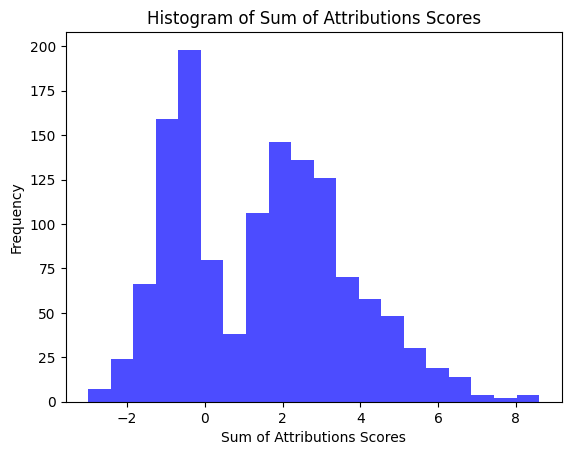

In [19]:
import matplotlib.pyplot as plt

# Create a histogram
filtered_sum_attributions = filter_sum_attributions(all_sum_attributions)
plt.hist(filtered_sum_attributions, bins=20, color='blue', alpha=0.7)
plt.title('Histogram of Sum of Attributions Scores')
plt.xlabel('Sum of Attributions Scores')
plt.ylabel('Frequency')
plt.show()

Percentile value: -0.4448469603168737
Percentile value: 1.6200079494382924
Percentile value: 2.9414638102734045


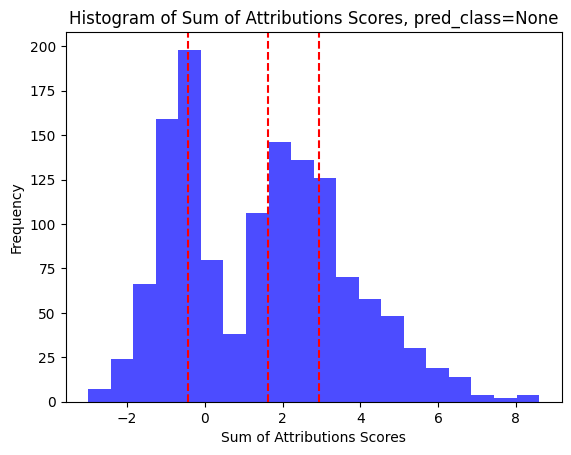

Percentile value: 1.9820887625357195
Percentile value: 2.7510232852821113
Percentile value: 3.791806594006069


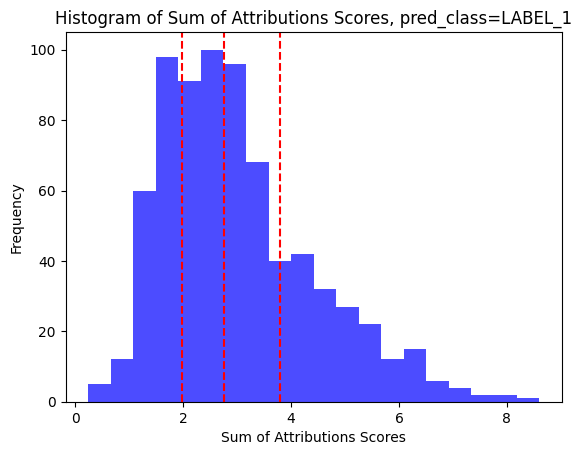

Percentile value: -1.0394857255106043
Percentile value: -0.5347143874959848
Percentile value: -0.10676671530967882


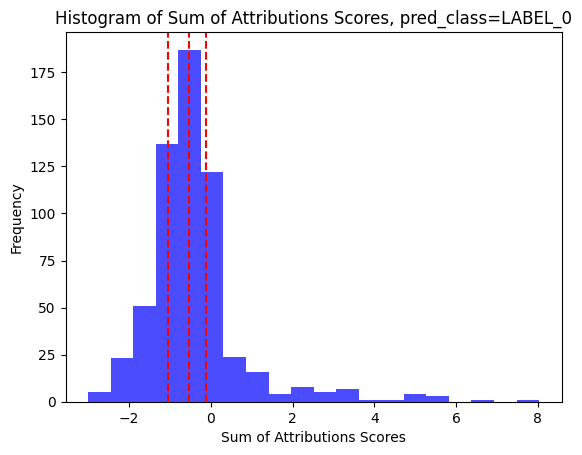

In [20]:
import numpy as np
import matplotlib.pyplot as plt

# Create histograms
for pred_class in [None, "LABEL_1", "LABEL_0"]:
    sum_attributions = filter_sum_attributions(all_sum_attributions, pred_class=pred_class)
    hist, bins, _ = plt.hist(sum_attributions, bins=20, color='blue', alpha=0.7)
    plt.title('Histogram of Sum of Attributions Scores, pred_class=' + str(pred_class))
    plt.xlabel('Sum of Attributions Scores')
    plt.ylabel('Frequency')

    # Calculate the percentiles
    percentiles = np.percentile(sum_attributions, [25, 50, 75])

    # Print the percentile values
    for percentile_value in percentiles:
        print("Percentile value:", percentile_value)

    # Draw red lines at the percentile values
    for percentile_value in percentiles:
        plt.axvline(percentile_value, color='red', linestyle='--')

    plt.show()

## Texts: highest scores

In [21]:
import numpy as np

# Set the desired maximum sequence length
max_sequence_length = 512

# Calculate the percentiles
# percentiles = np.percentile(all_total_attributions, [25, 75])

# Set the attribution threshold as the first and third percentile values
# attribution_threshold_lower = percentiles[0]
# attribution_threshold_upper = percentiles[1]

attribution_threshold_lower = -1.2264066739414712
attribution_threshold_upper = 3.9756553009835245

# Loop through all rows in the dataset
for row_index in range(len(df)):
    # Sum of attributions for the entire text
    sum_attribution = all_sum_attributions[row_index][0]

    # Check if the total attribution falls within the specified thresholds
    if abs(sum_attribution) < attribution_threshold_lower or abs(sum_attribution) > attribution_threshold_upper:
        # Extract row information
        preproc_text = get_preproc_text(df, row_index, tokenizer, max_sequence_length)
        word_attributions = cls_explainer(preproc_text)
        true_class = df.loc[row_index, trait]
        predicted_class = cls_explainer.predicted_class_name
        
        # Save the filtered attributions for this row
        attribution_info = (sum_attribution, true_class, predicted_class)

        # Print the information only for rows meeting the threshold
        print(f'True Class for Row {row_index}: {true_class}')
        print(f'Total Attribution for Row {row_index}: {sum_attribution}')

        # Visualize if needed
        if abs(sum_attribution) < attribution_threshold_lower or abs(sum_attribution) > attribution_threshold_upper:
            cls_explainer.visualize(true_class=true_class)


True Class for Row 2: 1
Total Attribution for Row 2: 6.170689883535587


True Class for Row 6: 1
Total Attribution for Row 6: 5.6104905635806945


True Class for Row 24: 1
Total Attribution for Row 24: 5.731531869012299


True Class for Row 37: 0
Total Attribution for Row 37: 4.205771323639442


True Class for Row 38: 0
Total Attribution for Row 38: 4.225931290231268


True Class for Row 44: 0
Total Attribution for Row 44: 4.950420700494551


True Class for Row 52: 1
Total Attribution for Row 52: 4.4214040673818795


True Class for Row 56: 1
Total Attribution for Row 56: 4.332226565156478


True Class for Row 60: 0
Total Attribution for Row 60: 6.154329458106041


True Class for Row 69: 0
Total Attribution for Row 69: 5.103771033556929


True Class for Row 74: 1
Total Attribution for Row 74: 6.435645727598627


True Class for Row 84: 1
Total Attribution for Row 84: 4.912936077491365


True Class for Row 99: 1
Total Attribution for Row 99: 5.113531982624564


True Class for Row 111: 1
Total Attribution for Row 111: 4.010176400062672


True Class for Row 113: 0
Total Attribution for Row 113: 5.623748615589253


True Class for Row 136: 0
Total Attribution for Row 136: 5.030125588522139


True Class for Row 139: 1
Total Attribution for Row 139: 4.237726427905203


True Class for Row 141: 1
Total Attribution for Row 141: 4.86272767676303


True Class for Row 154: 0
Total Attribution for Row 154: 4.006652466431464


True Class for Row 170: 1
Total Attribution for Row 170: 6.311559854263982


True Class for Row 176: 0
Total Attribution for Row 176: 5.511674496680367


True Class for Row 182: 0
Total Attribution for Row 182: 4.502424283164748


True Class for Row 184: 0
Total Attribution for Row 184: 4.995946877144102


True Class for Row 206: 1
Total Attribution for Row 206: 5.772662718716619


True Class for Row 211: 0
Total Attribution for Row 211: 6.541106520544027


True Class for Row 213: 0
Total Attribution for Row 213: 4.725325820610511


True Class for Row 218: 1
Total Attribution for Row 218: 4.575581145267673


True Class for Row 221: 1
Total Attribution for Row 221: 5.323577475810378


True Class for Row 223: 0
Total Attribution for Row 223: 6.05439553943244


True Class for Row 243: 0
Total Attribution for Row 243: 5.00429267320008


True Class for Row 244: 1
Total Attribution for Row 244: 6.425380281070977


True Class for Row 245: 0
Total Attribution for Row 245: 4.728108939855816


True Class for Row 277: 0
Total Attribution for Row 277: 4.18142768302545


True Class for Row 278: 0
Total Attribution for Row 278: 4.428927749025339


True Class for Row 279: 1
Total Attribution for Row 279: 4.0336673096067805


True Class for Row 282: 0
Total Attribution for Row 282: 4.044771050250512


True Class for Row 285: 1
Total Attribution for Row 285: 5.129779166167289


True Class for Row 287: 1
Total Attribution for Row 287: 4.125112653697267


True Class for Row 295: 1
Total Attribution for Row 295: 4.758302771835443


True Class for Row 296: 1
Total Attribution for Row 296: 4.004501878013565


True Class for Row 306: 0
Total Attribution for Row 306: 4.1366871482706635


True Class for Row 308: 0
Total Attribution for Row 308: 4.492974382898356


True Class for Row 315: 1
Total Attribution for Row 315: 4.598217269464222


True Class for Row 331: 1
Total Attribution for Row 331: 8.128296523100811


True Class for Row 333: 1
Total Attribution for Row 333: 5.340890639555838


True Class for Row 349: 1
Total Attribution for Row 349: 4.585545997147184


True Class for Row 355: 1
Total Attribution for Row 355: 4.106399533105424


True Class for Row 360: 0
Total Attribution for Row 360: 8.171744192061766


True Class for Row 375: 0
Total Attribution for Row 375: 4.724999264634954


True Class for Row 397: 1
Total Attribution for Row 397: 5.495308096012499


True Class for Row 399: 1
Total Attribution for Row 399: 5.000993567043614


True Class for Row 404: 1
Total Attribution for Row 404: 6.310296622073938


True Class for Row 405: 1
Total Attribution for Row 405: 4.489479361019556


True Class for Row 412: 0
Total Attribution for Row 412: 4.3071555219580855


True Class for Row 454: 1
Total Attribution for Row 454: 4.360325699457963


True Class for Row 458: 1
Total Attribution for Row 458: 4.818995632686523


True Class for Row 460: 0
Total Attribution for Row 460: 4.0001335591407745


True Class for Row 471: 1
Total Attribution for Row 471: 5.448588048532661


True Class for Row 507: 1
Total Attribution for Row 507: 4.182817128086408


True Class for Row 525: 0
Total Attribution for Row 525: 8.032451712545669


True Class for Row 536: 0
Total Attribution for Row 536: 4.238450967242552


True Class for Row 539: 0
Total Attribution for Row 539: 4.38621043175071


True Class for Row 544: 0
Total Attribution for Row 544: 4.823418448276594


True Class for Row 546: 0
Total Attribution for Row 546: 4.18316146662457


True Class for Row 549: 1
Total Attribution for Row 549: 3.9833736237654174


True Class for Row 552: 1
Total Attribution for Row 552: 7.709450485023905


True Class for Row 556: 1
Total Attribution for Row 556: 5.3701684365785445


True Class for Row 573: 1
Total Attribution for Row 573: 4.338344164418094


True Class for Row 578: 1
Total Attribution for Row 578: 4.914843973337767


True Class for Row 581: 1
Total Attribution for Row 581: 5.019046240204207


True Class for Row 582: 0
Total Attribution for Row 582: 6.096618440018065


True Class for Row 596: 1
Total Attribution for Row 596: 7.126532089875669


True Class for Row 600: 1
Total Attribution for Row 600: 5.279505470626946


True Class for Row 605: 1
Total Attribution for Row 605: 4.484402331108901


True Class for Row 609: 1
Total Attribution for Row 609: 4.266429855957036


True Class for Row 617: 1
Total Attribution for Row 617: 7.067641494089605


True Class for Row 618: 0
Total Attribution for Row 618: 8.598603062899958


True Class for Row 629: 1
Total Attribution for Row 629: 6.804637502049604


True Class for Row 638: 1
Total Attribution for Row 638: 5.6432485939052865


True Class for Row 640: 0
Total Attribution for Row 640: 4.052619543997793


True Class for Row 645: 1
Total Attribution for Row 645: 4.053983005670123


True Class for Row 663: 1
Total Attribution for Row 663: 5.443414880322283


True Class for Row 664: 0
Total Attribution for Row 664: 5.189909204387339


True Class for Row 669: 1
Total Attribution for Row 669: 4.591686611858546


True Class for Row 671: 1
Total Attribution for Row 671: 6.151669654837912


True Class for Row 673: 1
Total Attribution for Row 673: 5.5478076279985995


True Class for Row 674: 1
Total Attribution for Row 674: 4.021979919973111


True Class for Row 689: 1
Total Attribution for Row 689: 4.125289946962872


True Class for Row 698: 1
Total Attribution for Row 698: 5.047457708691168


True Class for Row 700: 1
Total Attribution for Row 700: 5.385659121018003


True Class for Row 701: 0
Total Attribution for Row 701: 5.507448552599879


True Class for Row 715: 0
Total Attribution for Row 715: 4.420281527262117


True Class for Row 717: 0
Total Attribution for Row 717: 4.234899425617513


True Class for Row 718: 0
Total Attribution for Row 718: 5.428713028167582


True Class for Row 721: 1
Total Attribution for Row 721: 5.203704484284511


True Class for Row 734: 0
Total Attribution for Row 734: 5.3992417543110705


True Class for Row 739: 1
Total Attribution for Row 739: 4.336731880960415


True Class for Row 745: 1
Total Attribution for Row 745: 4.9409828116139005


True Class for Row 754: 1
Total Attribution for Row 754: 4.311649711906018


True Class for Row 763: 1
Total Attribution for Row 763: 4.659654053619519


True Class for Row 775: 0
Total Attribution for Row 775: 4.101034304238743


True Class for Row 784: 1
Total Attribution for Row 784: 5.118354088544045


True Class for Row 791: 0
Total Attribution for Row 791: 5.984432950262422


True Class for Row 801: 0
Total Attribution for Row 801: 4.965744559790124


True Class for Row 806: 1
Total Attribution for Row 806: 5.714532572556911


KeyboardInterrupt: 

## Visualize sorted lists (explainer)

In [23]:
# Set the desired maximum sequence length
max_sequence_length = 512

# Obtain attributions
for pred_class in ["LABEL_1", "LABEL_0"]:

    sum_attributions = filter_sum_attributions(all_sum_attributions, pred_class=pred_class, get_attr_plus_idx=True)
    
    # Sort attributions
    sorted_list = sorted(sum_attributions, key=lambda x: x[0], reverse=True)

    # Visualize the attributions for the texts corresponding to the highest and lowest total attribution scores
    num_elements_to_show=10
    for element in sorted_list[:num_elements_to_show]:
        # Extract row information
        row_index = element[1]
        preproc_text = get_preproc_text(df, row_index, tokenizer, max_sequence_length)
        word_attributions = cls_explainer(preproc_text)
        true_class = df.loc[row_index, trait]
        predicted_class = cls_explainer.predicted_class_name

        # Sum of attributions for the entire text
        sum_attribution = cls_explainer.attributions.attributions_sum.sum()

        print(all_sum_attributions[row_index], sum_attribution)

        # Visualize the attributions for the text
        cls_explainer.visualize(true_class=true_class)

(8.598603062899958, 0, 'LABEL_1') tensor(8.5986, device='cuda:0', dtype=torch.float64)


(8.171744192061766, 0, 'LABEL_1') tensor(8.1717, device='cuda:0', dtype=torch.float64)


(8.128296523100811, 1, 'LABEL_1') tensor(8.1283, device='cuda:0', dtype=torch.float64)


(7.709450485023905, 1, 'LABEL_1') tensor(7.7095, device='cuda:0', dtype=torch.float64)


(7.526953167262171, 0, 'LABEL_1') tensor(7.5270, device='cuda:0', dtype=torch.float64)


(7.299020040453608, 1, 'LABEL_1') tensor(7.2990, device='cuda:0', dtype=torch.float64)


(7.141004143664424, 0, 'LABEL_1') tensor(7.1410, device='cuda:0', dtype=torch.float64)


(7.126532089875669, 1, 'LABEL_1') tensor(7.1265, device='cuda:0', dtype=torch.float64)


(7.067641494089605, 1, 'LABEL_1') tensor(7.0676, device='cuda:0', dtype=torch.float64)


(6.804637502049604, 1, 'LABEL_1') tensor(6.8046, device='cuda:0', dtype=torch.float64)


(8.032451712545669, 0, 'LABEL_0') tensor(8.0325, device='cuda:0', dtype=torch.float64)


(6.719916391871193, 0, 'LABEL_0') tensor(6.7199, device='cuda:0', dtype=torch.float64)


(5.623748615589253, 0, 'LABEL_0') tensor(5.6237, device='cuda:0', dtype=torch.float64)


(5.507448552599879, 0, 'LABEL_0') tensor(5.5074, device='cuda:0', dtype=torch.float64)


(5.428713028167582, 0, 'LABEL_0') tensor(5.4287, device='cuda:0', dtype=torch.float64)


(5.189909204387339, 0, 'LABEL_0') tensor(5.1899, device='cuda:0', dtype=torch.float64)


(5.030125588522139, 0, 'LABEL_0') tensor(5.0301, device='cuda:0', dtype=torch.float64)


(5.000993567043614, 1, 'LABEL_0') tensor(5.0010, device='cuda:0', dtype=torch.float64)


(4.965744559790124, 0, 'LABEL_0') tensor(4.9657, device='cuda:0', dtype=torch.float64)


(4.3071555219580855, 0, 'LABEL_0') tensor(4.3072, device='cuda:0', dtype=torch.float64)


## Trial

In [9]:
# Define a function to get the HTML file name
def get_html_fname(pred_class):
    return 'attributions_' + pred_class + '.html'

# Set the desired maximum sequence length
max_sequence_length = 512

# Initialize the HTML content
html_content = "<html><head><title>Essays with highest scores</title></head><body>"

# Obtain attributions
for pred_class in ["LABEL_1", "LABEL_0"]:

    sum_attributions = filter_sum_attributions(all_sum_attributions, pred_class=pred_class, get_attr_plus_idx=True)
    
    # Sort attributions
    sorted_list = sorted(sum_attributions, key=lambda x: x[0], reverse=True)

    # Visualize the attributions for the texts corresponding to the highest and lowest total attribution scores
    num_elements_to_show=10
    for element in sorted_list[:num_elements_to_show]:
        # Extract row information
        row_index = element[1]
        preproc_text = get_preproc_text(df, row_index, tokenizer, max_sequence_length)
        word_attributions = cls_explainer(preproc_text)
        true_class = df.loc[row_index, trait]
        predicted_class = cls_explainer.predicted_class_name

        # Sum of attributions for the entire text
        sum_attribution = cls_explainer.attributions.attributions_sum.sum()

        # Add the information to the HTML content
        html_content += f"<p>{all_sum_attributions[row_index]}, {sum_attribution}</p>"

        # Visualize the attributions for the text
        explanation_html = cls_explainer.visualize(true_class=true_class).data

        # Add the text to the HTML content
        html_content += str(explanation_html)

    # Close the HTML content
    html_content += "</body></html>"

    # Get the HTML file name
    html_fname = get_html_fname(pred_class)

    # Save the collected HTML content to a file
    with open(html_fname, 'w') as file:
        file.write(html_content)

    # Reset the HTML content for the next pred_class
    html_content = "<html><body>"

## Visualize sentences with a particular word (sum attribution ordering)

In [22]:
def get_html_fname_essays(word_of_interest):
    return 'avg_essay_' + word_of_interest.replace("/", "_") + '.html'

# Set the desired maximum sequence length
max_sequence_length = 512

# Define the list of words of interest and other parameters
words_of_interest = ["stupid", "line", "grade", "hungry", "fact"]
pred_class_of_interest = "LABEL_0"
max_elements_to_show = 10

for word_of_interest in words_of_interest:
    # Get filtered sum attributions
    sum_attributions = filter_sum_attributions(all_sum_attributions, pred_class=pred_class_of_interest, get_attr_plus_idx=True)
    
    # Sort attributions
    sorted_list = sorted(sum_attributions, key=lambda x: x[0], reverse=True)

    # Initialize HTML content string
    html_content = "<html><head><title>Word Attribution Scores</title></head><body>"

    num_elem = 0
    for element in sorted_list:
        # Extract row information
        row_index = element[1]
        
        word_attributions = all_word_attributions[row_index]
            
        # Check if word is contained in the current sentence
        score = get_max_word_score(word_of_interest, word_attributions)
        if score is not None:
            # Extract row information
            preproc_text = get_preproc_text(df, row_index, tokenizer, max_sequence_length)
            word_attributions = cls_explainer(preproc_text)
            true_class = df.loc[row_index, trait]
            predicted_class = cls_explainer.predicted_class_name
            
            # Print score
            print(word_of_interest, "score:", score)

            # Visualize and collect HTML content
            explanation_html = cls_explainer.visualize(true_class=true_class).data
            html_content += f"<h3>{word_of_interest} score: {score}</h3>"
            html_content += str(explanation_html)  # Ensure conversion to string
            
            num_elem += 1
            if num_elem == max_elements_to_show:
                break

    # Close the HTML content
    html_content += "</body></html>"

    # Close the HTML file name
    html_fname = get_html_fname_essays(word_of_interest)

    # Save the collected HTML content to a file
    with open(html_fname, 'w') as file:
        file.write(html_content)

stupid score: -0.06276196793033924


stupid score: 0.029435664577108903


stupid score: -0.005175578874118447


stupid score: 0.04206859459089066


stupid score: 0.4039549608346602


stupid score: 0.019225509969062485


stupid score: 0.014896251194017074


stupid score: 0.002028748256666562


stupid score: -0.046448456605984983


stupid score: -0.0098581098703883


line score: 0.032550651061998434


line score: -0.08919418250729985


line score: -0.021702391120586802


line score: 0.3096072659497744


line score: -0.13889419668476455


line score: -0.0023101871031714124


line score: 0.006768870558894414


line score: -0.1091017525692807


line score: 0.032317759739844264


grade score: 0.06398350231112485


grade score: 0.07047180595521046


grade score: 0.04057783683135977


grade score: -0.012282696546682225


grade score: 0.049157852798132964


grade score: 0.053960858970858804


grade score: 0.11653382710693398


grade score: -0.0019814309217852277


grade score: 0.2416087754015754


grade score: 0.2950894893502479


hungry score: -0.0601911880635298


hungry score: -0.12448960406191135


hungry score: 0.21888646926811198


hungry score: 0.05813279600755108


hungry score: -0.04334311994301801


hungry score: 0.0608856276086064


hungry score: 0.021685738905801607


hungry score: 0.1001197540361756


hungry score: 0.00686675774673927


hungry score: -0.014542736683506348


fact score: 0.24419249674256382


fact score: 0.004713384599215354


fact score: -0.006418095578118615


fact score: -0.015256381111247955


fact score: 0.019705645884253775


fact score: -0.006877823297781098


fact score: 0.038745777209872094


fact score: 0.02456241600857265


fact score: -0.008709819166340331


fact score: -0.0017362614152809988


## Visualize sentences with a particular word (word attribution ordering)

In [9]:
def get_html_fname_essays(word_of_interest):
    return 'avg_word_' + word_of_interest.replace("/", "_") + '.html'

# Set the desired maximum sequence length
max_sequence_length = 512

# Define the list of words of interest and other parameters
words_of_interest = ["stupid", "line", "grade", "hungry", "fact"]
pred_class_of_interest = "LABEL_0"
max_elements_to_show = 10

for word_of_interest in words_of_interest:
    # Get word score info
    word_scores = get_max_word_scores(word_of_interest, all_word_attributions, pred_class_of_interest)

    # Sort word scores
    sorted_list = sorted(word_scores, key=lambda x: x[0], reverse=True)

    # Initialize HTML content string
    html_content = "<html><head><title>Word Attribution Scores</title></head><body>"

    for element in sorted_list[:max_elements_to_show]:
        # Extract row information
        row_index = element[1]
        
        word_attributions = all_word_attributions[row_index]
            
        # Check if word is contained in the current sentence
        score = get_max_word_score(word_of_interest, word_attributions)
        
        # Extract row information
        preproc_text = get_preproc_text(df, row_index, tokenizer, max_sequence_length)
        word_attributions = cls_explainer(preproc_text)
        true_class = df.loc[row_index, trait]
        predicted_class = cls_explainer.predicted_class_name
            
        # Print score
        print(word_of_interest, "score:", score)

        # Visualize and collect HTML content
        explanation_html = cls_explainer.visualize(true_class=true_class).data
        html_content += f"<h3>{word_of_interest} score: {score}</h3>"
        html_content += explanation_html

    # Close HTML content string
    html_content += "</body></html>"

    # Get the HTML file name
    html_fname = get_html_fname_essays(word_of_interest)

    # Save the collected HTML content to a file
    with open(html_fname, 'w') as file:
        file.write(html_content)

stupid score: 0.4039549608346602


stupid score: 0.05245145029240759


stupid score: 0.04206859459089066


stupid score: 0.029435664577108903


stupid score: 0.028726250553041503


stupid score: 0.019709207753038933


stupid score: 0.019348910268098138


stupid score: 0.019225509969062485


stupid score: 0.014896251194017074


stupid score: 0.01094898863524607


line score: 0.3096072659497744


line score: 0.032550651061998434


line score: 0.032317759739844264


line score: 0.006768870558894414


line score: -0.0023101871031714124


line score: -0.021702391120586802


line score: -0.08919418250729985


line score: -0.1091017525692807


line score: -0.13889419668476455


grade score: 0.2950894893502479


grade score: 0.2416087754015754


grade score: 0.11653382710693398


grade score: 0.07047180595521046


grade score: 0.06398350231112485


grade score: 0.053960858970858804


grade score: 0.049157852798132964


grade score: 0.04057783683135977


grade score: -0.0019814309217852277


grade score: -0.012282696546682225


hungry score: 0.26520880508004063


hungry score: 0.26266065977739533


hungry score: 0.21888646926811198


hungry score: 0.2066234188821058


hungry score: 0.13243275765203058


hungry score: 0.1001197540361756


hungry score: 0.08228817144669413


hungry score: 0.0608856276086064


hungry score: 0.05813279600755108


hungry score: 0.05383184364851566


fact score: 0.24419249674256382


fact score: 0.038745777209872094


fact score: 0.036584936959197366


fact score: 0.02456241600857265


fact score: 0.02445159595230349


fact score: 0.02007357052113812


fact score: 0.019705645884253775


fact score: 0.009726796005722979


fact score: 0.008204888363420374


fact score: 0.004713384599215354
